# A Google Meridian PyMC-Marketing Comparison

Intro here

In [1]:
# Standard imports
import re
import time
import warnings

# IPython and Jupyter-specific
%load_ext autoreload
%autoreload 2
%config InlineBackend.figure_format = "retina"

# Third-party imports
import arviz as az
import matplotlib.dates as mdates
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import pymc as pm
import seaborn as sns
import tensorflow as tf
import tensorflow_probability as tfp
import xarray as xr
from pympler import asizeof
from statsmodels.stats.stattools import durbin_watson

import nutpie

# PyMC Marketing
from pymc_marketing.mmm import GeometricAdstock, LogisticSaturation, HillSaturationSigmoid
from pymc_marketing.mmm.multidimensional import (
    MMM,
    MultiDimensionalBudgetOptimizerWrapper,
)
from pymc_marketing.prior import Prior

# Meridian
from meridian import constants
from meridian.analysis import analyzer, formatter, optimizer, summarizer, visualizer
from meridian.data import (
    data_frame_input_data_builder,
    input_data,
    load,
    test_utils,
)
from meridian.model import model, prior_distribution, spec

# Data generation
from mmm_param_recovery.data_generator import (
    generate_mmm_dataset,
    get_preset_config,
)

# Warnings and plotting style
warnings.filterwarnings("ignore", category=UserWarning)
az.style.use("arviz-darkgrid")
plt.rcParams["figure.figsize"] = [12, 7]
plt.rcParams["figure.dpi"] = 100
plt.rcParams["xtick.labelsize"] = 10
plt.rcParams["ytick.labelsize"] = 8

2025-08-09 12:43:10.866424: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: SSE3 SSE4.1 SSE4.2 AVX AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
/opt/conda/envs/pixi-env/lib/python3.12/site-packages/pymc_marketing/mmm/multidimensional.py:72: FutureWarning: This functionality is experimental and subject to change. If you encounter any issues or have suggestions, please raise them at: https://github.com/pymc-labs/pymc-marketing/issues/new
  warnings.warn(warning_msg, FutureWarning, stacklevel=1)


In [2]:
# Set random seed for reproduceability
seed: int = sum(map(ord, "mmm_multidimensional"))
rng: np.random.Generator = np.random.default_rng(seed=seed)

## The Data

A description of the data

In [3]:
dataset_names = ["small_business", "growing_business", "medium_business"]

In [4]:
datasets = []
channel_columns_list = []
truth_dfs = []
for name in dataset_names:
    business_config = get_preset_config(name)
    business_result = generate_mmm_dataset(business_config)
    data_df = business_result['data'].rename(columns = {"date": "time"})
    print(f"{name.replace("_", " ").title()} dataset shape: {data_df.shape}")
    data_df["population"] = 1
    print(f"Regions: {data_df['geo'].unique()}")
    print(f"Date range: {data_df['time'].min()} to {data_df['time'].max()}")
    print("")
    print("="*20)
    print("")
    datasets.append(data_df)
    channel_columns_list.append([col for col in data_df.columns if re.match(r"x\d+", col)])
    truth_dfs.append(business_result['ground_truth']['transformed_spend'].reset_index().rename(columns={"date": "time"}))


Small Business dataset shape: (104, 11)
Regions: ['Local']
Date range: 2020-01-05 00:00:00 to 2021-12-26 00:00:00


Growing Business dataset shape: (262, 13)
Regions: ['geo_a' 'geo_b']
Date range: 2020-01-05 00:00:00 to 2022-07-03 00:00:00


Medium Business dataset shape: (1248, 19)
Regions: ['geo_a' 'geo_b' 'geo_c' 'geo_d' 'geo_e' 'geo_f' 'geo_g' 'geo_h']
Date range: 2020-01-05 00:00:00 to 2022-12-25 00:00:00




## Data Pre-Processing

In [5]:
# Meridian

# Storage for built data objects
built_data_objects = []

for data_df, channel_columns in zip(datasets, channel_columns_list):
    # Detect control columns in the form of 'c1', ..., 'c10' if present
    potential_controls = ['c1', 'c2', 'c3', 'c4', 'c5', 'c6', 'c7', 'c8', 'c9', 'c10']
    control_cols = [col for col in potential_controls if col in data_df.columns]

    # Start building the data input
    builder = (
        data_frame_input_data_builder.DataFrameInputDataBuilder(kpi_type='revenue')
        .with_kpi(data_df, kpi_col="y")
        .with_population(data_df)
    )

    # Add controls only if any are found
    if control_cols:
        builder = builder.with_controls(data_df, control_cols=control_cols)

    # Add media columns
    builder = builder.with_media(
        data_df,
        media_cols=channel_columns,
        media_spend_cols=channel_columns,
        media_channels=channel_columns,
    )

    # Finalize the builder and store the result
    built_data = builder.build()
    built_data_objects.append(built_data)

# PyMC-Marketing
# None required.

## Prior Specification 

**Meridian**

- Uses spend share as prior variance for $\beta$ parameters, across channels - does not allow for geo level.
- Hierarchical structure accross the saturation parameters - Meridian does this by default.
- Setting knots to occur every 26 weeks, to best align with seasonality of order 2.

**PyMC-Marketing**

- Using spend share as prior for $\beta$ parameters, across channels and geos.
- Hierarchical structure accross the saturation parameters.
- Includes fourier seasonality of order 2.

In [6]:
spend_share_list = []
prior_sigma_list = []

for data_df, channel_columns in zip(datasets, channel_columns_list):
    n_channels = len(channel_columns)

    # Group and sum media spend by geo
    sum_spend_geo_channel = data_df.groupby("geo")[channel_columns].sum()

    # Calculate spend share
    spend_share = (
        sum_spend_geo_channel.to_numpy() /
        sum_spend_geo_channel.sum(axis=1).to_numpy()[:, None]
    )

    # Calculate prior sigma
    prior_sigma = n_channels * spend_share

    # Store results
    prior_sigma_list.append(prior_sigma)


In [7]:
meridian_priors = []
pymc_saturation_objects = []

for data, channel_columns, prior_sigma in zip(built_data_objects, channel_columns_list, prior_sigma_list):
    # Meridian setup
    n_time = len(data.time)
    knots = np.arange(0, n_time, 26).tolist()

    build_media_channel_args = data.get_paid_media_channels_argument_builder()

    beta_m = build_media_channel_args(
        **{
            col: (0, float(prior_sigma.mean(axis=0)[i]))
            for i, col in enumerate(channel_columns)
        }
    )

    beta_m_mu, beta_m_sigma = zip(*beta_m)

    prior = prior_distribution.PriorDistribution(
        beta_m=tfp.distributions.LogNormal(
            beta_m_mu, beta_m_sigma, name=constants.BETA_M
        )
    )
    meridian_priors.append(prior)

    # PyMC-Marketing setup

    saturation = HillSaturationSigmoid(
        priors = {
            "sigma":  Prior("InverseGamma", mu=1.5, sigma=prior_sigma.T, dims=("channel", "geo")),
            "beta": Prior("HalfNormal", sigma=1.5, dims = ("channel", "geo")),
            "lam": Prior(
               "Gamma",
               mu=Prior("LogNormal", mu=np.log(2), sigma=np.log(1.5), dims="channel"),
               sigma=Prior("LogNormal", mu=np.log(1), sigma=np.log(1.2), dims="channel"),
               dims=("channel", "geo"),
           ),
        },
    )

    pymc_saturation_objects.append(saturation)

## Model Specification

**Meridian**

This is a geo-level model with the following specification:

$$
y_{g,t} = \mu_{t} +\tau_{g} + \sum_{i=1}^{N_C} \gamma^{[C]}_{g,i} z_{g,t,i} 
+ \sum_{i=1}^{N_M} \beta^{[M]}_{g,i} \text{HillAdstock} \left( \{ x^{[M]}_{g,t-s,i} \}_{s=0}^{L} ; \alpha^{[M]}_i, ec^{[M]}_{i}, slope^{[M]}_{i} \right) + \epsilon_{g,t}
$$

Where:

- $\mu_{t}$ represents the intercept at time $t$.
- $\tau_{g}$ represents the intercept for geo $g$.
- $\sum_{i=1}^{N_C} \gamma^{[C]}_{g,i} z_{g,t,i}$ represents the control contribution at time $t$ for geo $g$.
- $\sum_{i=1}^{N_M} \beta^{[M]}_{g,i} \text{HillAdstock} \left( \{ x^{[M]}_{g,t-s,i} \}_{s=0}^{L} ; \alpha^{[M]}_i, ec^{[M]}_{i}, slope^{[M]}_{i} \right)$ represents the adstocked saturated media contribution at time $t$ for geo $g$.
- $\epsilon_{g,t}$ represents the error at time $t$ for geo $g$

----

**PyMC-Marketing**

This is a geo-level model with the following specification:

$$
y_{g,t} = \mu_g + \sum_{i=0}^{4} \gamma^{[F]}_{g,i} f_{g,t,i} 
+ \sum_{i=1}^{N_C} \gamma^{[C]}_{g,i} z_{g,t,i} 
+ \sum_{i=1}^{N_M} \beta^{[M]}_{g,i} \text{LogisticAdstock} \left( \{ x^{[M]}_{g,t-s,i} \}_{s=0}^{L} ; \alpha^{[M]}_i, \lambda^{[M]}_{g,t,i}\right) + \epsilon_{g,t}
$$

Where:

- $\mu_g$ represents the intercept for geo g.
- $\sum_{i=0}^{4} \gamma^{[F]}_{g,i} f_{g,t,i}$ represents the seasonality/fourier contribution (order 2) at time $t$ for geo $g$.
- $\sum_{i=1}^{N_C} \gamma^{[C]}_{g,i} z_{g,t,i}$ represents the control contribution at time $t$ for geo $g$.
- $\sum_{i=1}^{N_M} \beta^{[M]}_{g,i} \text{LogisticAdstock} \left( \{ x^{[M]}_{g,t-s,i} \}_{s=0}^{L} ; \alpha^{[M]}_i, \lambda^{[M]}_{g,t,i}\right)$ represents the adstocked saturated media contribution at time $t$ for geo $g$.
- $\epsilon_{g,t}$ represents the error at time $t$ for geo $g$

In [8]:
meridian_model_specs = []
pymc_mmm_models = []

for data_df, data, channel_columns, prior, saturation in zip(
    datasets,
    built_data_objects,
    channel_columns_list,
    meridian_priors,
    pymc_saturation_objects
):
    # Detect existing control columns (c1 to cN)
    potential_controls = ['c'+ str(i) for i in range(len(data_df.columns))]
    control_columns = [col for col in potential_controls if col in data_df.columns]
    
    # Meridian: model spec
    n_time = len(data.time)
    knots = np.arange(0, n_time, 26).tolist()

    model_spec = spec.ModelSpec(
        prior=prior,
        media_effects_dist='log_normal',
        hill_before_adstock=False,
        max_lag=8,
        unique_sigma_for_each_geo=True,
        roi_calibration_period=None,
        rf_roi_calibration_period=None,
        knots=knots,
        baseline_geo=None,
        holdout_id=None,
        control_population_scaling_id=None,
        media_prior_type='coefficient',
        rf_prior_type='coefficient',
    )
    meridian_model_specs.append(model_spec)

    # PyMC-Marketing: MMM model
    mmm = MMM(
        date_column="time",
        target_column="y",
        channel_columns=channel_columns,
        control_columns=control_columns,
        dims=("geo",),
        scaling={
            "channel": {"method": "max", "dims": ()},
            "target": {"method": "max", "dims": ()},
        },
        saturation=saturation,
        adstock=GeometricAdstock(l_max=8),
        yearly_seasonality=2,
    )
    pymc_mmm_models.append(mmm)


## Model Building

In [9]:
meridian_models = []
pymc_built_models = []

for data_df, data, model_spec, mmm in zip(
    datasets,
    built_data_objects,
    meridian_model_specs,
    pymc_mmm_models
):
    # --- Meridian ---
    meridian_instance = model.Meridian(input_data=data, model_spec=model_spec)
    meridian_models.append(meridian_instance)

    # --- PyMC-Marketing ---
    x_train = data_df.drop(columns=["y"])
    y_train = data_df["y"]

    mmm.build_model(X=x_train, y=y_train)

    # Base contribution variables
    contribution_vars = [
        "channel_contribution",
        "intercept_contribution",
        "yearly_seasonality_contribution",
        "y",
    ]

    # Add control contribution only if controls exist
    if any(col in data_df.columns for col in ["c1", "c2", "c3", "c4"]):
        contribution_vars.insert(1, "control_contribution")

    mmm.add_original_scale_contribution_variable(var=contribution_vars)

    pymc_built_models.append(mmm)

In [10]:
meridian_models

In [11]:
pymc_built_models

## Prior Sampling

In [12]:
meridian_prior_samples = []
pymc_prior_predictives = []
pymc_scalers = []

for meridian_model, mmm_model, data_df in zip(
    meridian_models,
    pymc_built_models,
    datasets
):
    # --- Meridian ---
    meridian_model.sample_prior(1000)
    meridian_prior_samples.append(meridian_model)

    # --- PyMC-Marketing ---
    x_train = data_df.drop(columns=["y"])
    y_train = data_df["y"]

    prior_predictive = mmm_model.sample_prior_predictive(X=x_train, y=y_train, samples=1000)
    scalers = mmm_model.get_scales_as_xarray()

    pymc_prior_predictives.append(prior_predictive)
    pymc_scalers.append(scalers)

Sampling: [adstock_alpha, gamma_control, gamma_fourier, intercept_contribution, saturation_beta, saturation_lam, saturation_lam_mu, saturation_lam_sigma, saturation_sigma, y, y_sigma]
Sampling: [adstock_alpha, gamma_control, gamma_fourier, intercept_contribution, saturation_beta, saturation_lam, saturation_lam_mu, saturation_lam_sigma, saturation_sigma, y, y_sigma]
Sampling: [adstock_alpha, gamma_control, gamma_fourier, intercept_contribution, saturation_beta, saturation_lam, saturation_lam_mu, saturation_lam_sigma, saturation_sigma, y, y_sigma]


## Posterior Sampling
We aim to observe the following:
- Speed comparisons
- Memory comparisons
- Convergence analysis

In [13]:
# Define your samplers
samplers = ["pymc", "blackjax", "numpyro", "nutpie"]

# Initialize runtime tracking
run_times = {
    "Dataset": [],
    "Meridian": [],
}

esss = {
    "Dataset": [],
    "Meridian": [],
}
for sampler in samplers:
    run_times[f"PyMC-Marketing - {sampler} sampler"] = []
    esss[f"PyMC-Marketing - {sampler} sampler"] = []

# Loop through datasets and models
for i, (meridian_model, mmm_model, data_df) in enumerate(zip(
    meridian_models,
    pymc_built_models,
    datasets
), start=1):
    dataset_name = dataset_names[i-1]
    print(f"\n--- Dataset {i} ({dataset_name}) ---")
    run_times["Dataset"].append(dataset_name)
    esss["Dataset"] += [dataset_name] * 3

    # --- Meridian Posterior Sampling ---
    try:
        start = time.perf_counter()
        meridian_model.sample_posterior(
            n_chains=4, 
            n_adapt=1000, 
            n_burnin=500, 
            n_keep=1000
        )
        meridian_time = time.perf_counter() - start
        print(f"Meridian sampling took {meridian_time:.2f} seconds.")
    except Exception as e:
        meridian_time = None
        print(f"Meridian sampling failed: {e}")
    es = az.ess(meridian_model.inference_data)
    es = np.quantile(np.concat([es[var].values.flatten() for var in es.data_vars]),[0.1,0.5,0.9])
    run_times["Meridian"].append(meridian_time)
    esss["Meridian"] += list(es)

    # Prepare data
    x_train = data_df.drop(columns=["y"])
    y_train = data_df["y"]

    # --- PyMC-Marketing Sampling for each sampler ---
    for sampler in samplers:
        try:
            print(f"Running PyMC-Marketing with '{sampler}' sampler...")

            sampler_kwargs = {}
            if sampler == "nutpie":
                sampler_kwargs["nuts_sampler_kwargs"] = {"backend": "jax", "gradient_backend": "jax"}

            # Fit model
            start = time.perf_counter()
            mmm_model.fit(
                X=x_train,
                y=y_train,
                chains=4,
                draws=1000,
                tune=1000,
                target_accept=0.9,
                random_seed=rng,
                nuts_sampler=sampler,
                **sampler_kwargs
            )
            pymc_sample_time = time.perf_counter() - start
            print(f"  Sampling took {pymc_sample_time:.2f} seconds.")

            # Posterior predictive sampling
            start = time.perf_counter()
            mmm_model.sample_posterior_predictive(
                X=x_train,
                extend_idata=True,
                combined=True,
                random_seed=rng,
            )
            pymc_pp_time = time.perf_counter() - start
            print(f"  Posterior predictive took {pymc_pp_time:.2f} seconds.")

            total_time = pymc_sample_time + pymc_pp_time
            es = az.ess(mmm_model.idata)
            es = np.quantile(np.concat([es[var].values.flatten() for var in es.data_vars]),[0.1,0.5,0.9])

        except Exception as e:
            total_time = None
            print(f"  PyMC-Marketing with '{sampler}' failed: {e}")

        run_times[f"PyMC-Marketing - {sampler} sampler"].append(total_time)
        esss[f"PyMC-Marketing - {sampler} sampler"] += list(es)
        
# Create final DataFrame
runtime_df = pd.DataFrame(run_times)
runtime_df.set_index("Dataset", inplace=True)

ess_df = pd.DataFrame(esss)

# Display result
display(runtime_df)



--- Dataset 1 (small_business) ---


2025-08-09 12:45:59.519210: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:268] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2025-08-09 12:46:00.562666: W tensorflow/compiler/tf2xla/kernels/random_ops.cc:107] Warning: Using tf.random.uniform with XLA compilation will ignore seeds; consider using tf.random.stateless_uniform instead if reproducible behavior is desired. sanitize_seed/seed


Meridian sampling took 187.25 seconds.
Running PyMC-Marketing with 'pymc' sampler...


Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [intercept_contribution, adstock_alpha, saturation_sigma, saturation_beta, saturation_lam_mu, saturation_lam_sigma, saturation_lam, gamma_control, gamma_fourier, y_sigma]


Output()

Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 150 seconds.
There were 5 divergences after tuning. Increase `target_accept` or reparameterize.


Output()

  Sampling took 297.21 seconds.


Sampling: [y]


Output()

  Posterior predictive took 2.86 seconds.
Running PyMC-Marketing with 'blackjax' sampler...
Running window adaptation


Output()

Sampling: [y]


Output()

  Sampling took 43.20 seconds.


  Posterior predictive took 0.72 seconds.
Running PyMC-Marketing with 'numpyro' sampler...


  0%|          | 0/2000 [00:00<?, ?it/s]

  0%|          | 0/2000 [00:00<?, ?it/s]

  0%|          | 0/2000 [00:00<?, ?it/s]

  0%|          | 0/2000 [00:00<?, ?it/s]

Output()

  Sampling took 28.63 seconds.


Sampling: [y]


Output()

  Posterior predictive took 1.98 seconds.
Running PyMC-Marketing with 'nutpie' sampler...


Progress,Draws,Divergences,Step Size,Gradients/Draw
,2000,1,0.12,63
,2000,0,0.14,31
,2000,1,0.14,31
,2000,2,0.13,63


Output()

Sampling: [y]


Output()

  Sampling took 143.97 seconds.


  Posterior predictive took 0.77 seconds.

--- Dataset 2 (growing_business) ---
Meridian sampling took 467.62 seconds.
Running PyMC-Marketing with 'pymc' sampler...


Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [intercept_contribution, adstock_alpha, saturation_sigma, saturation_beta, saturation_lam_mu, saturation_lam_sigma, saturation_lam, gamma_control, gamma_fourier, y_sigma]
/opt/conda/envs/pixi-env/lib/python3.12/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


Output()

/opt/conda/envs/pixi-env/lib/python3.12/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 240 seconds.
There were 4 divergences after tuning. Increase `target_accept` or reparameterize.


Output()

Sampling: [y]


Output()

  Sampling took 305.11 seconds.


  Posterior predictive took 1.06 seconds.
Running PyMC-Marketing with 'blackjax' sampler...
Running window adaptation


Output()

Sampling: [y]


Output()

  Sampling took 150.64 seconds.


  Posterior predictive took 0.73 seconds.
Running PyMC-Marketing with 'numpyro' sampler...


  0%|          | 0/2000 [00:00<?, ?it/s]

  0%|          | 0/2000 [00:00<?, ?it/s]

  0%|          | 0/2000 [00:00<?, ?it/s]

  0%|          | 0/2000 [00:00<?, ?it/s]

Output()

Sampling: [y]


Output()

  Sampling took 147.78 seconds.


  Posterior predictive took 0.73 seconds.
Running PyMC-Marketing with 'nutpie' sampler...


Progress,Draws,Divergences,Step Size,Gradients/Draw
,2000,1,0.11,255
,2000,0,0.11,63
,2000,0,0.11,191
,2000,1,0.12,127


Output()

Sampling: [y]


Output()

  Sampling took 208.79 seconds.


  Posterior predictive took 0.77 seconds.

--- Dataset 3 (medium_business) ---
Meridian sampling took 337.84 seconds.
Running PyMC-Marketing with 'pymc' sampler...


Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [intercept_contribution, adstock_alpha, saturation_sigma, saturation_beta, saturation_lam_mu, saturation_lam_sigma, saturation_lam, gamma_control, gamma_fourier, y_sigma]
/opt/conda/envs/pixi-env/lib/python3.12/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


Output()

/opt/conda/envs/pixi-env/lib/python3.12/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 1642 seconds.
There were 32 divergences after tuning. Increase `target_accept` or reparameterize.
The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details
The effective sample size per chain is smaller than 100 for some parameters.  A higher number is needed for reliable rhat and ess computation. See https://arxiv.org/abs/1903.08008 for details


Output()

Sampling: [y]


Output()

  Sampling took 1655.57 seconds.


  Posterior predictive took 1.06 seconds.
Running PyMC-Marketing with 'blackjax' sampler...
Running window adaptation


The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details
The effective sample size per chain is smaller than 100 for some parameters.  A higher number is needed for reliable rhat and ess computation. See https://arxiv.org/abs/1903.08008 for details


Output()

Sampling: [y]


Output()

  Sampling took 1029.17 seconds.


  Posterior predictive took 0.99 seconds.
Running PyMC-Marketing with 'numpyro' sampler...


  0%|          | 0/2000 [00:00<?, ?it/s]

  0%|          | 0/2000 [00:00<?, ?it/s]

  0%|          | 0/2000 [00:00<?, ?it/s]

  0%|          | 0/2000 [00:00<?, ?it/s]

The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details
The effective sample size per chain is smaller than 100 for some parameters.  A higher number is needed for reliable rhat and ess computation. See https://arxiv.org/abs/1903.08008 for details


Output()

Sampling: [y]


Output()

  Sampling took 1118.82 seconds.


  Posterior predictive took 1.02 seconds.
Running PyMC-Marketing with 'nutpie' sampler...


Progress,Draws,Divergences,Step Size,Gradients/Draw
,2000,4,0.04,255
,2000,11,0.04,255
,2000,5,0.04,511
,2000,9,0.04,255


Output()

Sampling: [y]


Output()

  Sampling took 853.07 seconds.


  Posterior predictive took 1.04 seconds.


,Meridian,PyMC-Marketing - pymc sampler,PyMC-Marketing - blackjax sampler,PyMC-Marketing - numpyro sampler,PyMC-Marketing - nutpie sampler
Dataset,,,,,
small_business,187.249592,300.071588,43.916167,30.615160,144.743315
growing_business,467.624644,306.167162,151.365488,148.519381,209.553368
medium_business,337.843367,1656.625876,1030.166337,1119.839196,854.107606


In [15]:
df = ess_df.melt(id_vars = "Dataset")
df["ESS"] = ["5%", "50%", "95%"] * 5 * len(dataset_names)
df.rename(columns={"variable":"Sampler"}).pivot(index = ["Dataset", "Sampler"], columns="ESS", values = "value").sort_values(by="50%", ascending=False).round(2)

ESS                                                      5%      50%      95%
Dataset          Sampler                                                     
growing_business PyMC-Marketing - blackjax sampler  3448.06  4149.44  6550.58
                 PyMC-Marketing - numpyro sampler   3508.07  4098.36  6031.49
                 PyMC-Marketing - pymc sampler      3343.64  4044.49  5665.09
                 PyMC-Marketing - nutpie sampler    3193.66  4000.00  5207.74
medium_business  PyMC-Marketing - nutpie sampler    3376.81  4000.00  4619.52
                 PyMC-Marketing - pymc sampler      2467.27  3833.93  4520.25
small_business   PyMC-Marketing - blackjax sampler  2361.59  3748.14  5482.21
                 PyMC-Marketing - numpyro sampler   1835.71  3518.45  4886.95
                 PyMC-Marketing - pymc sampler      2154.21  3420.08  4000.00
                 PyMC-Marketing - nutpie sampler    1458.74  2789.66  4457.16
                 Meridian                           1758.44  2117.14  4000.00
medium_business  Meridian                           1214.25  1383.37  4592.35
growing_business Meridian                           1130.69  1295.52  4000.00
medium_business  PyMC-Marketing - blackjax sampler     4.49     5.52  4000.00
                 PyMC-Marketing - numpyro sampler      4.44     5.22  4000.00

In [16]:
df = (ess_df.set_index("Dataset") / runtime_df).reset_index().melt(id_vars = "Dataset")
df["ESS / s"] = ["5%", "50%", "95%"] * 5 * len(dataset_names)
df.rename(columns={"variable":"Sampler"}).pivot(index = ["Dataset", "Sampler"], columns="ESS / s", values = "value").sort_values(by="50%", ascending=False).round(2)

ESS / s                                                5%     50%     95%
Dataset          Sampler                                                 
small_business   PyMC-Marketing - numpyro sampler   59.96  114.92  159.63
                 PyMC-Marketing - blackjax sampler  53.77   85.35  124.83
growing_business PyMC-Marketing - numpyro sampler   23.62   27.59   40.61
                 PyMC-Marketing - blackjax sampler  22.78   27.41   43.28
small_business   PyMC-Marketing - nutpie sampler    10.08   19.27   30.79
growing_business PyMC-Marketing - nutpie sampler    15.24   19.09   24.85
                 PyMC-Marketing - pymc sampler      10.92   13.21   18.50
small_business   PyMC-Marketing - pymc sampler       7.18   11.40   13.33
                 Meridian                            9.39   11.31   21.36
medium_business  PyMC-Marketing - nutpie sampler     3.95    4.68    5.41
                 Meridian                            3.59    4.09   13.59
growing_business Meridian                            2.42    2.77    8.55
medium_business  PyMC-Marketing - pymc sampler       1.49    2.31    2.73
                 PyMC-Marketing - blackjax sampler   0.00    0.01    3.88
                 PyMC-Marketing - numpyro sampler    0.00    0.00    3.57

**Note** PyMC-Marketing stores the data and contributions as a part of the model object, meridian does not.

In [17]:
for i, (meridian_model, mmm_model) in enumerate(zip(
    meridian_models,
    pymc_built_models
), start=1):
    dataset_name = dataset_names[i - 1].split("_")[0]
    print(f"\n--- Dataset {i} ({dataset_name}) ---")

    # Meridian model size
    meridian_size = asizeof.asizeof(meridian_model)
    print(f"Meridian model size: {meridian_size / (1024 ** 2):.2f} MB")

    # PyMC-Marketing model size
    pymc_size = asizeof.asizeof(mmm_model)
    print(f"PyMC-Marketing model size: {pymc_size / (1024 ** 2):.2f} MB")



--- Dataset 1 (small) ---
Meridian model size: 3.44 MB
PyMC-Marketing model size: 159.55 MB

--- Dataset 2 (growing) ---
Meridian model size: 4.43 MB
PyMC-Marketing model size: 466.39 MB

--- Dataset 3 (medium) ---
Meridian model size: 7.12 MB
PyMC-Marketing model size: 2885.29 MB


In [18]:
for i, (meridian_model, mmm_model) in enumerate(zip(
    meridian_models,
    pymc_built_models
), start=1):
    dataset_name = dataset_names[i - 1].split("_")[0]
    print(f"\n--- Dataset {i} ({dataset_name}) ---")

    # --- Meridian Diagnostics ---
    divergences = meridian_model.inference_data.sample_stats.diverging.sum().item()
    print(f"Meridian number of divergences: {divergences}")

    meridian_rhat_max = az.summary(
        meridian_model.inference_data,
        var_names=[
            "alpha_m", "beta_gm", "beta_m", "ec_m",
            "gamma_c", "gamma_gc", "sigma", "tau_g",
            "xi_c", "knot_values", "mu_t"
        ]
    )['r_hat'].max()
    print(f"Meridian maximum r_hat: {meridian_rhat_max:.3f}")

    # --- PyMC-Marketing Diagnostics ---
    divergences = mmm_model.idata.sample_stats.diverging.sum().item()
    print(f"PyMC-Marketing number of divergences: {divergences}")

    pymc_rhat_max = az.summary(
        mmm_model.idata,
        var_names=[
            "adstock_alpha", "gamma_control", "gamma_fourier",
            "intercept_contribution", "saturation_beta",
            "saturation_lam", "saturation_sigma", "y_sigma"
        ]
    )['r_hat'].max()
    print(f"PyMC-Marketing maximum r_hat: {pymc_rhat_max:.3f}")



--- Dataset 1 (small) ---
Meridian number of divergences: 0


/opt/conda/envs/pixi-env/lib/python3.12/site-packages/arviz/stats/diagnostics.py:596: RuntimeWarning: invalid value encountered in scalar divide
  (between_chain_variance / within_chain_variance + num_samples - 1) / (num_samples)
/opt/conda/envs/pixi-env/lib/python3.12/site-packages/arviz/stats/diagnostics.py:991: RuntimeWarning: invalid value encountered in scalar divide
  varsd = varvar / evar / 4


Meridian maximum r_hat: 1.000
PyMC-Marketing number of divergences: 4
PyMC-Marketing maximum r_hat: 1.010

--- Dataset 2 (growing) ---
Meridian number of divergences: 161


/opt/conda/envs/pixi-env/lib/python3.12/site-packages/arviz/stats/diagnostics.py:596: RuntimeWarning: invalid value encountered in scalar divide
  (between_chain_variance / within_chain_variance + num_samples - 1) / (num_samples)
/opt/conda/envs/pixi-env/lib/python3.12/site-packages/arviz/stats/diagnostics.py:991: RuntimeWarning: invalid value encountered in scalar divide
  varsd = varvar / evar / 4


Meridian maximum r_hat: 1.010
PyMC-Marketing number of divergences: 2
PyMC-Marketing maximum r_hat: 1.000

--- Dataset 3 (medium) ---
Meridian number of divergences: 0


/opt/conda/envs/pixi-env/lib/python3.12/site-packages/arviz/stats/diagnostics.py:596: RuntimeWarning: invalid value encountered in scalar divide
  (between_chain_variance / within_chain_variance + num_samples - 1) / (num_samples)
/opt/conda/envs/pixi-env/lib/python3.12/site-packages/arviz/stats/diagnostics.py:991: RuntimeWarning: invalid value encountered in scalar divide
  varsd = varvar / evar / 4


Meridian maximum r_hat: 1.010
PyMC-Marketing number of divergences: 29
PyMC-Marketing maximum r_hat: 1.010


## Predictive Performance

#### Meridian

In [19]:
for i, (mmm_model, data_df) in enumerate(zip(meridian_models, datasets), start=1):
    dataset_name = dataset_names[i - 1].split("_")[0]
    print(f"\n--- Plotting Posterior Predictive for Meridian model ({dataset_name}) ---")
    model_fit = visualizer.ModelFit(mmm_model) # 0 = small, 1 = medium and 2 = large
    fig = model_fit.plot_model_fit(
        n_top_largest_geos=len(data_df["geo"].unique()),
        show_geo_level=True,
        include_baseline=False,
        include_ci=True
    )
    fig.show()



--- Plotting Posterior Predictive for Meridian model (small) ---


alt.FacetChart(...)


--- Plotting Posterior Predictive for Meridian model (growing) ---


alt.FacetChart(...)


--- Plotting Posterior Predictive for Meridian model (medium) ---


alt.FacetChart(...)

#### PyMC-Marketing


--- Plotting Posterior Predictive for PyMC-Marketing model (small) ---


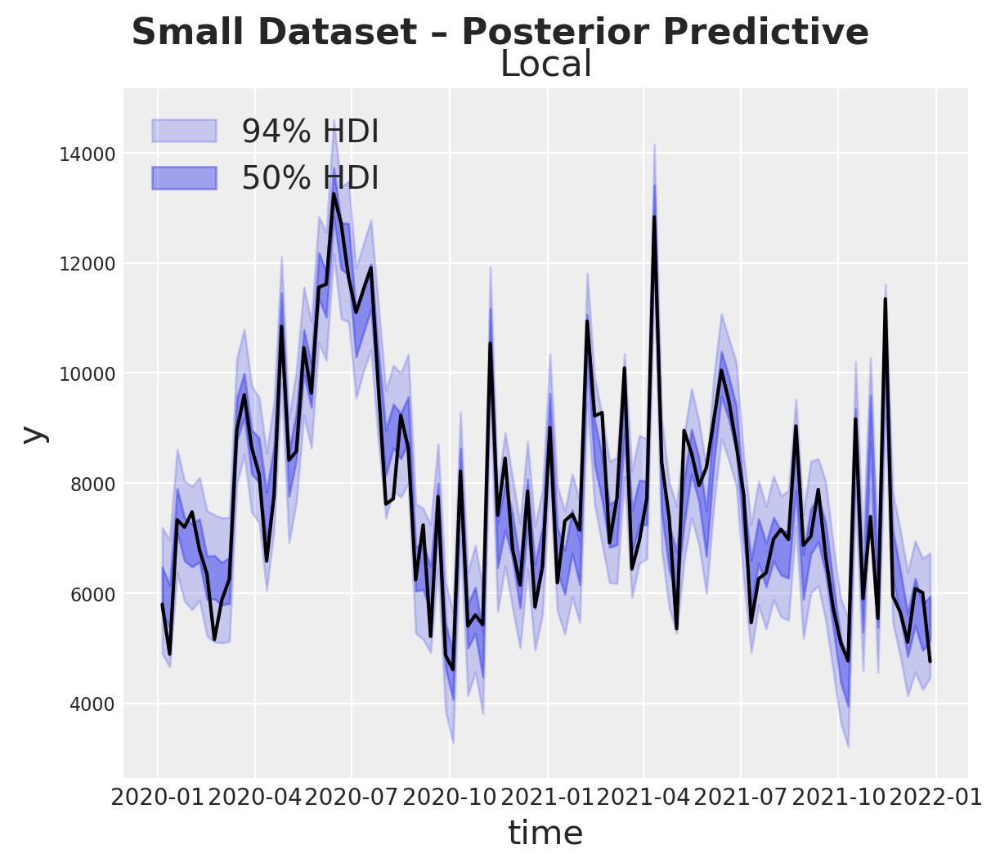


--- Plotting Posterior Predictive for PyMC-Marketing model (growing) ---


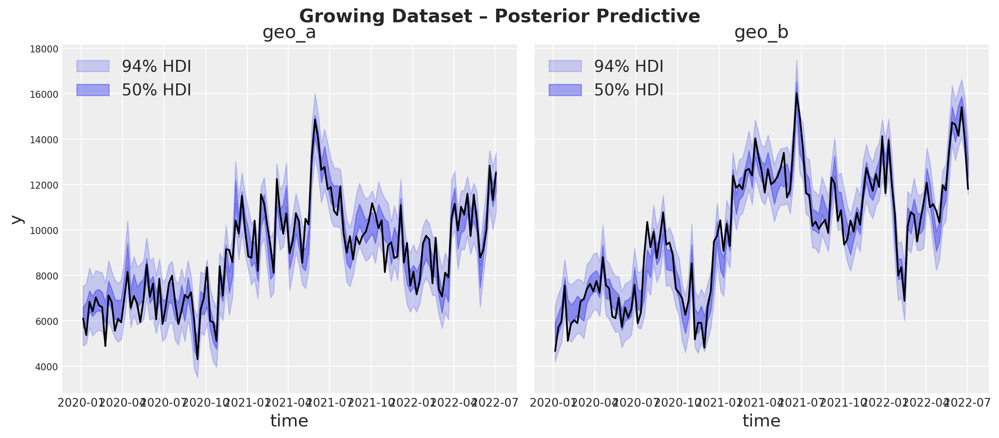


--- Plotting Posterior Predictive for PyMC-Marketing model (medium) ---


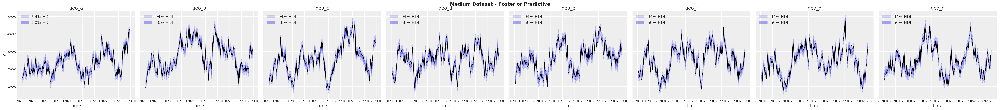

In [20]:
for i, (mmm_model, data_df) in enumerate(zip(pymc_built_models, datasets), start=1):
    dataset_name = dataset_names[i - 1].split("_")[0]
    print(f"\n--- Plotting Posterior Predictive for PyMC-Marketing model ({dataset_name}) ---")

    geos = mmm_model.model.coords["geo"]
    dates = mmm_model.model.coords["date"]

    fig, axes = plt.subplots(
        ncols=len(geos),
        figsize=(6 * len(geos), 5),
        sharex=True,
        sharey=True,
        layout="constrained",
    )

    # Ensure axes is iterable
    if len(geos) == 1:
        axes = [axes]

    for j, geo in enumerate(geos):
        ax = axes[j]
        # 94% HDI
        az.plot_hdi(
            x=dates,
            y=mmm_model.idata["posterior_predictive"].y_original_scale.sel(geo=geo),
            color="C0",
            smooth=False,
            hdi_prob=0.94,
            fill_kwargs={"alpha": 0.2, "label": "94% HDI"},
            ax=ax,
        )

        # 50% HDI
        az.plot_hdi(
            x=dates,
            y=mmm_model.idata["posterior_predictive"].y_original_scale.sel(geo=geo),
            color="C0",
            smooth=False,
            hdi_prob=0.5,
            fill_kwargs={"alpha": 0.4, "label": "50% HDI"},
            ax=ax,
        )

        # Actual data
        sns.lineplot(
            data=data_df.query("geo == @geo"),
            x="time",
            y="y",
            color="black",
            ax=ax,
        )

        ax.legend(loc="upper left")
        ax.set(title=f"{geo}")

    fig.suptitle(f"{dataset_name.title()} Dataset – Posterior Predictive", fontsize=16, fontweight="bold", y=1.03)
    plt.show()


In [21]:
# Collect all rows
all_performance_rows = []

dataset_order = {name: i for i, name in enumerate(dataset_names)}

# --- Meridian ---
for i, meridian_model in enumerate(meridian_models, start=1):
    dataset_name = dataset_names[i - 1].split("_")[0]
    model_analysis = analyzer.Analyzer(meridian_model)
    fit_data = model_analysis.expected_vs_actual_data()

    for geo in fit_data.geo.values:
        geo_label = "geo_a" if geo == "national_geo" else geo

        expected = fit_data['expected'].sel(geo=geo, metric="mean")
        actual = fit_data['actual'].sel(geo=geo)

        expected_vals = expected.values
        actual_vals = actual.values

        mask = ~np.isnan(expected_vals) & ~np.isnan(actual_vals)
        expected_vals = expected_vals[mask]
        actual_vals = actual_vals[mask]

        if len(expected_vals) < 3:
            continue

        ss_res = np.sum((actual_vals - expected_vals) ** 2)
        ss_tot = np.sum((actual_vals - np.mean(actual_vals)) ** 2)
        r2 = 1 - ss_res / ss_tot if ss_tot != 0 else np.nan

        nonzero_mask = actual_vals != 0
        mape = (np.abs((actual_vals[nonzero_mask] - expected_vals[nonzero_mask]) / actual_vals[nonzero_mask])).mean() * 100

        residuals = actual_vals - expected_vals
        dw = durbin_watson(residuals)

        all_performance_rows.append({
            "Library": "Meridian",
            "Geo": geo_label,
            "Dataset": dataset_name,
            "R²": round(r2, 4) if not np.isnan(r2) else None,
            "MAPE (%)": round(mape, 2),
            "Durbin-Watson": round(dw, 3)
        })

# --- PyMC-Marketing ---
for i, (mmm_model, data_df) in enumerate(zip(pymc_built_models, datasets), start=1):
    dataset_name = dataset_names[i - 1].split("_")[0]

    for geo in mmm_model.model.coords["geo"]:
        geo_label = "Local" if geo == "national_geo" else geo

        expected = mmm_model.idata["posterior_predictive"].y_original_scale.mean(['chain', 'draw']).sel(geo=geo)
        actual_vals = data_df.loc[data_df["geo"] == geo, "y"]

        expected_vals = expected.values
        actual_vals = actual_vals.values

        mask = ~np.isnan(expected_vals) & ~np.isnan(actual_vals)
        expected_vals = expected_vals[mask]
        actual_vals = actual_vals[mask]

        if len(expected_vals) < 3:
            continue

        ss_res = np.sum((actual_vals - expected_vals) ** 2)
        ss_tot = np.sum((actual_vals - np.mean(actual_vals)) ** 2)
        r2 = 1 - ss_res / ss_tot if ss_tot != 0 else np.nan

        nonzero_mask = actual_vals != 0
        mape = (np.abs((actual_vals[nonzero_mask] - expected_vals[nonzero_mask]) / actual_vals[nonzero_mask])).mean() * 100

        residuals = actual_vals - expected_vals
        dw = durbin_watson(residuals)

        all_performance_rows.append({
            "Library": "PyMC-Marketing",
            "Geo": geo_label,
            "Dataset": dataset_name,
            "R²": round(r2, 4) if not np.isnan(r2) else None,
            "MAPE (%)": round(mape, 2),
            "Durbin-Watson": round(dw, 3)
        })

# --- Create and sort final DataFrame ---
performance_df = pd.DataFrame(all_performance_rows)

# Sort by dataset order and geo
performance_df["dataset_order"] = performance_df["Dataset"].map(dataset_order)
performance_df = performance_df.sort_values(by=["dataset_order", "Geo", "Library"]).drop(columns="dataset_order")

# Melt to long format for metrics
melted_df = performance_df.melt(
    id_vars=["Dataset", "Geo", "Library"],
    value_vars=["R²", "MAPE (%)", "Durbin-Watson"],
    var_name="Metric",
    value_name="Value"
)

# Pivot to get columns per library
final_df = melted_df.pivot_table(
    index=["Dataset", "Geo", "Metric"],
    columns="Library",
    values="Value"
).reset_index()

# Remove the column index name (optional)
final_df.columns.name = None

# Reorder and keep only relevant columns
final_df = final_df[["Dataset", "Geo", "Metric", "PyMC-Marketing", "Meridian"]]

# Display final clean table (no 'Library' column)
print("\n=== Final Model Performance Comparison ===")
display(final_df)



=== Final Model Performance Comparison ===


,Dataset,Geo,Metric,PyMC-Marketing,Meridian
0,growing,geo_a,Durbin-Watson,1.8690,1.4400
1,growing,geo_a,MAPE (%),6.0300,5.8900
2,growing,geo_a,R²,0.9104,0.9135
3,growing,geo_b,Durbin-Watson,1.5520,0.9370
4,growing,geo_b,MAPE (%),5.1000,7.9200
5,growing,geo_b,R²,0.9523,0.8956
6,medium,geo_a,Durbin-Watson,1.5420,0.3680
7,medium,geo_a,MAPE (%),4.9400,11.9000
8,medium,geo_a,R²,0.9575,0.7764
9,medium,geo_b,Durbin-Watson,1.5140,0.2240


## Contribution Recovery

In [22]:
predicted_contributions_ds_meridian_list = []
predicted_contributions_ds_pymc_marketing_list = []

for i, (meridian_model, data, mmm_model) in enumerate(zip(
    meridian_models,
    built_data_objects,
    pymc_built_models
), start=1):
    dataset_name = dataset_names[i - 1].split("_")[0]
    print(f"\n--- Predicting Contributions for Dataset: {dataset_name} ---")

    # --- Meridian: Predict Contributions ---
    model_analysis = analyzer.Analyzer(meridian_model)

    incremental_df = model_analysis.incremental_outcome(
        aggregate_times=False,
        aggregate_geos=False,
        use_kpi=True,
    )

    mean_np = tf.reduce_mean(incremental_df, axis=[0, 1]).numpy()
    lower_np = tfp.stats.percentile(incremental_df, 3, axis=[0, 1]).numpy()
    upper_np = tfp.stats.percentile(incremental_df, 97, axis=[0, 1]).numpy()

    stacked = tf.stack([mean_np, lower_np, upper_np], axis=0).numpy()

    contrib_da = xr.DataArray(
        stacked,
        dims=["hdi", "geo", "time", "media_channel"],
        coords={
            "hdi": ["mean", "lower", "upper"],
            "geo": data.geo.coords["geo"].values,
            "time": data.time.coords["time"].values,
            "media_channel": data.media.coords["media_channel"].values
        },
        name="contribution"
    )

    predicted_contributions_ds_meridian = contrib_da.to_dataset()
    predicted_contributions_ds_meridian_list.append(predicted_contributions_ds_meridian)

    # --- PyMC-Marketing: Predict Contributions ---
    contribution_da = mmm_model.idata["posterior"]["channel_contribution_original_scale"]
    predicted_contributions_ds_pymc_marketing_list.append(contribution_da)



--- Predicting Contributions for Dataset: small ---

--- Predicting Contributions for Dataset: growing ---

--- Predicting Contributions for Dataset: medium ---


In [23]:
true_contributions_ds_list = []

for i, truth_df in enumerate(truth_dfs):
    dataset_name = dataset_names[i - 1].split("_")[0]
    print(f"\n--- Processing ground truth for: {dataset_name} ---")

    contrib_df = truth_df.copy()
    channel_cols = [col for col in contrib_df.columns if col.startswith("contribution")]

    long_contrib_df = contrib_df.melt(
        id_vars=["time", "geo"],
        value_vars=channel_cols,
        var_name="media_channel",
        value_name="contribution"
    )

    long_contrib_df["media_channel"] = long_contrib_df["media_channel"]
    long_contrib_df["time"] = pd.to_datetime(long_contrib_df["time"])

    true_contributions_da = (
        long_contrib_df
        .set_index(["time", "geo", "media_channel"])
        .to_xarray()
    )["contribution"]

    true_contributions_ds = true_contributions_da.to_dataset(name="contribution")
    true_contributions_ds_list.append(true_contributions_ds)



--- Processing ground truth for: medium ---

--- Processing ground truth for: small ---

--- Processing ground truth for: growing ---


#### Meridian


--- Plotting Contributions Grid with Truth (small) ---


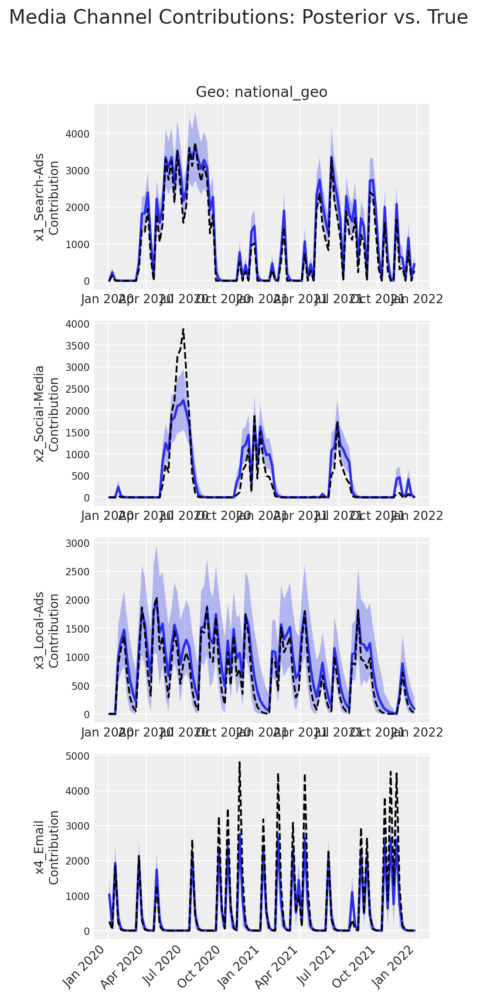


--- Plotting Contributions Grid with Truth (growing) ---


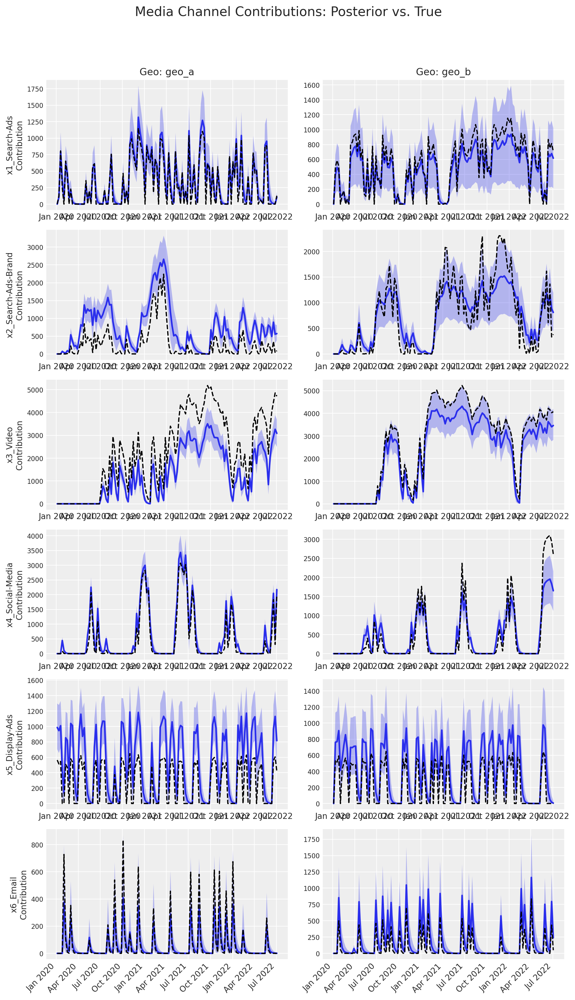


--- Plotting Contributions Grid with Truth (medium) ---


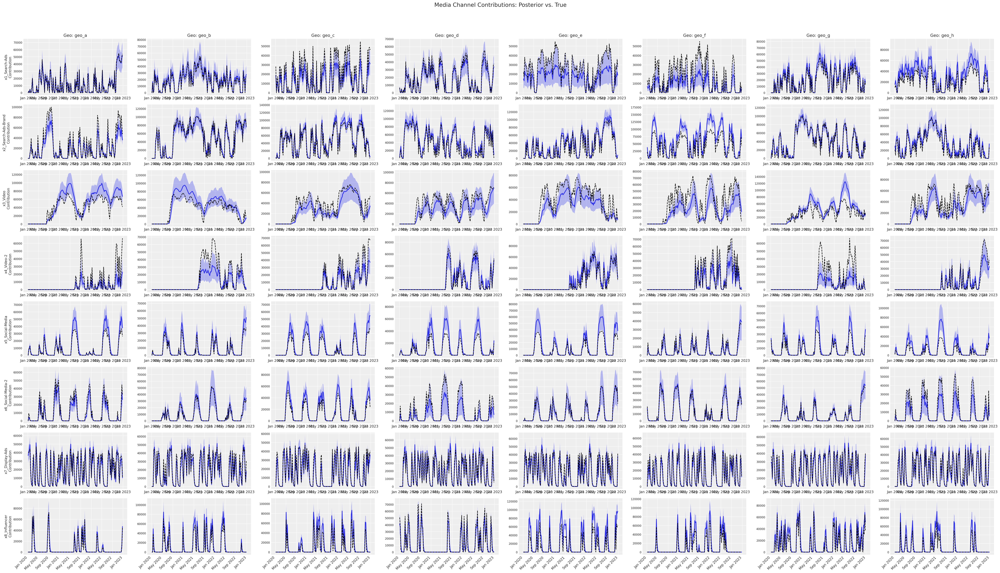

In [24]:
def plot_contributions_grid_with_truth(predicted_contributions_ds, true_contributions_ds):
    """
    Plots a grid of time series with rows = media_channel and cols = geo,
    shading between HDI bounds (lower and upper), and overlays true contributions.

    Parameters:
        predicted_contributions_ds (xarray.Dataset): Posterior Dataset with dims (hdi, geo, time, media_channel)
                                                     and coords hdi=["mean", "lower", "upper"].
        true_contributions_ds (xarray.Dataset): True contributions Dataset with dims
                                                (time, geo, media_channel) and variable "contribution".
    """
    da = predicted_contributions_ds["contribution"]

    geos = da.geo.values
    channels = da.media_channel.values
    time = pd.to_datetime(da.time.values)

    n_rows = len(channels)
    n_cols = len(geos)

    fig, axs = plt.subplots(n_rows, n_cols, figsize=(5 * n_cols, 3 * n_rows), sharex=False, sharey=False)
    if n_rows == 1 and n_cols == 1:
        axs = np.array([[axs]])
    elif n_rows == 1:
        axs = np.array([axs])
    elif n_cols == 1:
        axs = np.array([[ax] for ax in axs])


    for i, channel in enumerate(channels):
        for j, geo in enumerate(geos):
            ax = axs[i, j]

            # Posterior mean + HDI
            mean = da.sel(hdi="mean", geo=geo, media_channel=channel)
            lower = da.sel(hdi="lower", geo=geo, media_channel=channel)
            upper = da.sel(hdi="upper", geo=geo, media_channel=channel)

            ax.plot(time, mean, label="Mean", linewidth=2)
            ax.fill_between(time, lower, upper, alpha=0.3, label="HDI (3%–97%)")

            # True contribution
            true_channel = f"contribution_{channel}"
            #try:
            truth = true_contributions_ds['contribution'].sel(media_channel = true_channel, geo= "geo_a" if geo  == "national_geo" else geo)
            truth = truth.sel(time=time)
            ax.plot(time, truth, linestyle="--", color="black", label="True", linewidth=1.5)
            #except KeyError:
            #    pass  # Skip if not found

            if i == 0:
                ax.set_title(f"Geo: {geo}", fontsize=12)
            if j == 0:
                ax.set_ylabel(f"{channel}\nContribution", fontsize=10)

            ax.grid(True)
            ax.xaxis.set_major_locator(mdates.AutoDateLocator())
            ax.xaxis.set_major_formatter(mdates.DateFormatter("%b %Y"))

    for ax in axs[-1]:
        plt.setp(ax.get_xticklabels(), rotation=45, ha="right")

    fig.suptitle("Media Channel Contributions: Posterior vs. True", fontsize=16)
    fig.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()
    
for i, (predicted_contributions_ds, true_contributions_ds) in enumerate(zip(
    predicted_contributions_ds_meridian_list,
    true_contributions_ds_list
), start=1):
    dataset_name = dataset_names[i - 1].split("_")[0]
    print(f"\n--- Plotting Contributions Grid with Truth ({dataset_name}) ---")

    true = true_contributions_ds.copy(deep=True)

    # Rename geo in the true dataset for small business (index 0)
    if i == 1 and "Local" in true.geo.values:
        true = true.assign_coords(geo=["geo_a"] if len(true.geo) == 1 else [
            "geo_a" if g == "Local" else g for g in true.geo.values
        ])

    plot_contributions_grid_with_truth(predicted_contributions_ds, true)

#### PyMC-Marketing


--- Plotting Contributions Grid with Truth (small) ---


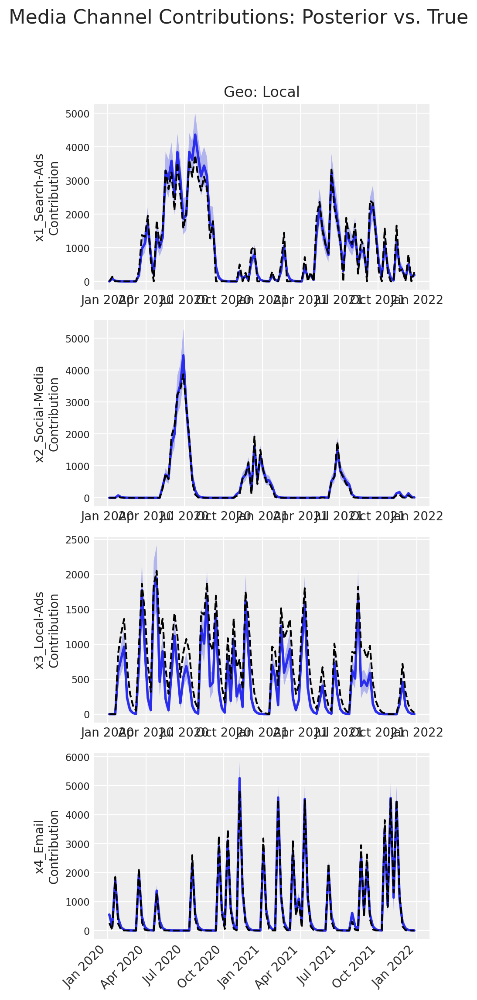


--- Plotting Contributions Grid with Truth (growing) ---


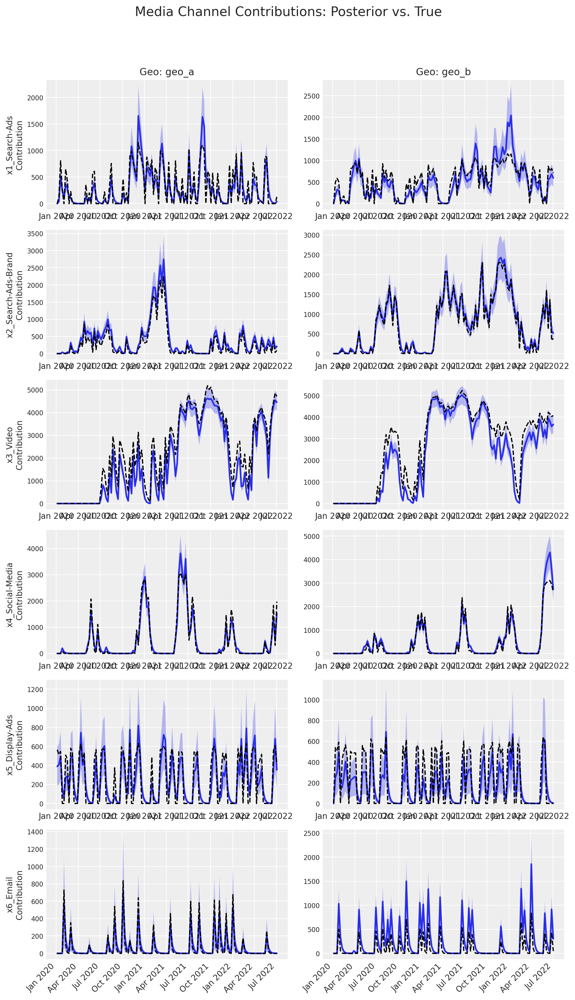


--- Plotting Contributions Grid with Truth (medium) ---


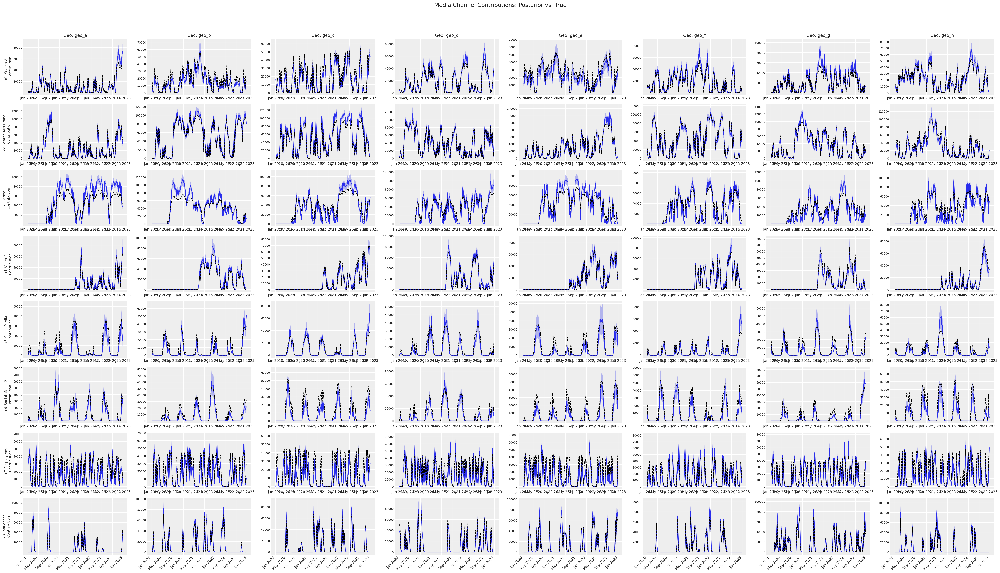

In [25]:
def plot_contributions_grid_with_truth(predicted_contributions_ds, true_contributions_ds):
    """
    Plots a grid of time series with rows = media_channel and cols = geo,
    shading between HDI bounds (3rd–97th percentiles), and overlays true contributions.

    Parameters:
        predicted_contributions_ds (xarray.Dataset): Dataset with dims (chain, draw, date, geo, channel)
        true_contributions_ds (xarray.Dataset): Dataset with vars like 'contribution_x1-seasonal-1'
                                                and dims (date, geo)
    """
    # Extract data
    da = predicted_contributions_ds

    # Collapse (chain, draw) into posterior samples axis
    stacked = da.stack(sample=("chain", "draw"))

    # Compute posterior mean and HDI bounds
    mean = stacked.mean(dim="sample")
    lower = stacked.quantile(0.03, dim="sample")
    upper = stacked.quantile(0.97, dim="sample")

    geos = da.coords["geo"].values
    channels = da.coords["channel"].values
    dates = pd.to_datetime(da.coords["date"].values)

    n_rows = len(channels)
    n_cols = len(geos)

    fig, axs = plt.subplots(n_rows, n_cols, figsize=(5 * n_cols, 3 * n_rows), sharex=False, sharey=False)

    # Normalize axs to always be 2D
    if n_rows == 1 and n_cols == 1:
        axs = np.array([[axs]])
    elif n_rows == 1:
        axs = np.array([axs])
    elif n_cols == 1:
        axs = np.array([[ax] for ax in axs])

    for i, channel in enumerate(channels):
        for j, geo in enumerate(geos):
            ax = axs[i, j]

            mean_ts = mean.sel(geo=geo, channel=channel)
            lower_ts = lower.sel(geo=geo, channel=channel)
            upper_ts = upper.sel(geo=geo, channel=channel)

            ax.plot(dates, mean_ts, label="Mean", linewidth=2)
            ax.fill_between(dates, lower_ts, upper_ts, alpha=0.3, label="HDI (3%–97%)")

            # Plot true contributions
            true_var = f"contribution_{channel}"
            try:
                truth = true_contributions_ds['contribution'].sel(media_channel = true_var, geo=geo)
                truth = truth.sel(time=dates)
                ax.plot(dates, truth, linestyle="--", color="black", label="True", linewidth=1.5)
            except KeyError:
                pass  # skip if not found

            if i == 0:
                ax.set_title(f"Geo: {geo}", fontsize=12)
            if j == 0:
                ax.set_ylabel(f"{channel}\nContribution", fontsize=10)

            ax.grid(True)
            ax.xaxis.set_major_locator(mdates.AutoDateLocator())
            ax.xaxis.set_major_formatter(mdates.DateFormatter("%b %Y"))

    for ax in axs[-1]:
        plt.setp(ax.get_xticklabels(), rotation=45, ha="right")

    fig.suptitle("Media Channel Contributions: Posterior vs. True", fontsize=16)
    fig.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

for i, (predicted_ds, true_ds) in enumerate(zip(
    predicted_contributions_ds_pymc_marketing_list,
    true_contributions_ds_list
), start=1):
    dataset_name = dataset_names[i - 1].split("_")[0]
    print(f"\n--- Plotting Contributions Grid with Truth ({dataset_name}) ---")

    # Deep copy both datasets
    pred = predicted_ds.copy(deep=True)
    true = true_ds.copy(deep=True)

    # ✅ Fix geo name in predicted dataset (not true!) for small dataset
    if i == 1 and "Local" in pred.geo.values:
        pred = pred.rename({'geo': 'geo'})  # ensures coordinate is named
        pred = pred.assign_coords(geo=("geo", ["national geo"]))

    plot_contributions_grid_with_truth(predicted_ds, true)


In [26]:
all_detailed_rows = []
summary_rows = []

def compute_smape_rows(predicted_ds, true_ds, lib_type, dataset_name):
    results = []

    def smape(a, f):
        return 100 * np.mean(2 * np.abs(f - a) / (np.abs(f) + np.abs(a) + 1e-8))

    if lib_type == "Meridian":
        pred_da = predicted_ds["contribution"].sel(hdi='mean')
        for geo in true_ds.coords["geo"].values:
            for channel in pred_da.coords["media_channel"].values:
                try:
                    pred = pred_da.sel(geo=geo if "national_geo" not in pred_da.coords["geo"].values else "national_geo", media_channel=channel)
                    try:
                        true = true_ds['contribution'].sel(media_channel=channel, geo=geo)
                    except KeyError:
                        true = true_ds['contribution'].sel(media_channel=f"contribution_{channel}", geo=geo)

                    pred_series = pd.Series(pred.values, index=pd.to_datetime(pred.coords["time"].values))
                    true_series = pd.Series(true.values, index=pd.to_datetime(true.coords["time"].values))

                    df = pd.DataFrame({"pred": pred_series, "true": true_series}).dropna()
                    df = df[df["true"] != 0]

                    if not df.empty:
                        smape_val = smape(df["true"], df["pred"])
                        results.append({
                            "Library": lib_type,
                            "Dataset": dataset_name,
                            "geo": geo,
                            "media_channel": channel,
                            "SMAPE (%)": round(smape_val, 2)
                        })

                except KeyError:
                    continue

    elif lib_type == "PyMC Marketing":
        pred_mean = predicted_ds.mean(dim=["chain", "draw"])
        for geo in predicted_ds.geo.values:
            # normalized_geo = "National" if geo in ["national_geo", "Local"] else geo
            for channel in predicted_ds.channel.values:
                try:
                    pred = pred_mean.sel(geo=geo, channel=channel)
                    try:
                        true = true_ds['contribution'].sel(media_channel=channel, geo=geo)
                    except KeyError:
                        true = true_ds['contribution'].sel(media_channel=f"contribution_{channel}", geo=geo)

                    pred_series = pd.Series(pred.values, index=pd.to_datetime(pred["date"].values))
                    true_series = pd.Series(true.values, index=pd.to_datetime(true["time"].values))

                    df = pd.DataFrame({"pred": pred_series, "true": true_series}).dropna()
                    df = df[df["true"] != 0]

                    if not df.empty:
                        smape_val = smape(df["true"], df["pred"])
                        results.append({
                            "Library": lib_type,
                            "Dataset": dataset_name,
                            "geo": geo,
                            "media_channel": channel,
                            "SMAPE (%)": round(smape_val, 2)
                        })

                except KeyError:
                    continue

    return results

# Meridian
for i, (predicted_ds, true_ds) in enumerate(zip(
    predicted_contributions_ds_meridian_list,
    true_contributions_ds_list
), start=1):
    dataset_name = dataset_names[i - 1].split("_")[0]
    true = true_ds.copy(deep=True)

    rows = compute_smape_rows(predicted_ds, true, lib_type="Meridian", dataset_name=dataset_name)
    all_detailed_rows.extend(rows)
    if rows:
        summary_rows.append({
            "Library": "Meridian",
            "Dataset": dataset_name,
            "Average SMAPE": round(np.mean([r["SMAPE (%)"] for r in rows]), 2)
        })

# PyMC Marketing
for i, (predicted_ds, true_ds) in enumerate(zip(
    predicted_contributions_ds_pymc_marketing_list,
    true_contributions_ds_list
), start=1):
    dataset_name = dataset_names[i - 1].split("_")[0]
    rows = compute_smape_rows(predicted_ds, true_ds, lib_type="PyMC Marketing", dataset_name=dataset_name)
    all_detailed_rows.extend(rows)
    if rows:
        summary_rows.append({
            "Library": "PyMC Marketing",
            "Dataset": dataset_name,
            "Average SMAPE": round(np.mean([r["SMAPE (%)"] for r in rows]), 2)
        })

# Convert to DataFrames
detailed_df = pd.DataFrame(all_detailed_rows)
summary_df = pd.DataFrame(summary_rows)

# === Format summary: pivot and clean ===
summary_df = summary_df.pivot(
    index="Dataset",
    columns="Library",
    values="Average SMAPE"
).reset_index()
summary_df.columns.name = None
summary_df = summary_df.round(2)

# === Format detailed: pivot and clean ===
detailed_df = detailed_df.pivot_table(
    index=["Dataset", "geo", "media_channel"],
    columns="Library",
    values="SMAPE (%)"
).reset_index()
detailed_df.columns.name = None
detailed_df = detailed_df.round(2)

# Display
print("\n=== Summary: Average SMAPE per Dataset ===")
display(summary_df)

print("\n=== Detailed SMAPE by Dataset, Geo, and Channel ===")
display(detailed_df)



=== Summary: Average SMAPE per Dataset ===


,Dataset,Meridian,PyMC Marketing
0,growing,78.83,74.97
1,medium,61.72,57.34
2,small,73.42,81.32



=== Detailed SMAPE by Dataset, Geo, and Channel ===


,Dataset,geo,media_channel,Meridian,PyMC Marketing
0,growing,geo_a,x1_Search-Ads,14.01,40.99
1,growing,geo_a,x2_Search-Ads-Brand,135.32,95.03
2,growing,geo_a,x3_Video,68.60,43.76
3,growing,geo_a,x4_Social-Media,120.10,109.61
4,growing,geo_a,x5_Display-Ads,55.05,34.11
...,...,...,...,...,...
75,medium,geo_h,x8_Influencer,137.30,110.86
76,small,Local,x1_Search-Ads,30.21,23.09
77,small,Local,x2_Social-Media,126.54,102.63
78,small,Local,x3_Local-Ads,52.65,89.17


In [27]:
all_mape_rows = []
mape_summary_rows = []

def compute_mape_rows(predicted_ds, true_ds, lib_type, dataset_name):
    results = []

    def mape(a, f):
        return 100 * np.mean(np.abs((a - f) / (a + 1e-8)))  # Avoid divide-by-zero

    if lib_type == "Meridian":
        pred_da = predicted_ds["contribution"].sel(hdi='mean')
        for geo in true_ds.coords["geo"].values:
            for channel in pred_da.coords["media_channel"].values:
                try:
                    pred = pred_da.sel(geo=geo if "national_geo" not in pred_da.coords["geo"].values else "national_geo", media_channel=channel)
                    try:
                        true = true_ds['contribution'].sel(media_channel=channel, geo=geo)
                    except KeyError:
                        true = true_ds['contribution'].sel(media_channel=f"contribution_{channel}", geo=geo)

                    pred_series = pd.Series(pred.values, index=pd.to_datetime(pred.coords["time"].values))
                    true_series = pd.Series(true.values, index=pd.to_datetime(true.coords["time"].values))

                    df = pd.DataFrame({"pred": pred_series, "true": true_series}).dropna()
                    df = df[df["true"] != 0]

                    if not df.empty:
                        mape_val = mape(df["true"], df["pred"])
                        results.append({
                            "Library": lib_type,
                            "Dataset": dataset_name,
                            "geo": geo,
                            "media_channel": channel,
                            "MAPE (%)": round(mape_val, 2)
                        })

                except KeyError:
                    continue

    elif lib_type == "PyMC Marketing":
        pred_mean = predicted_ds.mean(dim=["chain", "draw"])
        for geo in predicted_ds.geo.values:
            for channel in predicted_ds.channel.values:
                try:
                    pred = pred_mean.sel(geo=geo, channel=channel)
                    try:
                        true = true_ds['contribution'].sel(media_channel=channel, geo=geo)
                    except KeyError:
                        true = true_ds['contribution'].sel(media_channel=f"contribution_{channel}", geo=geo)

                    pred_series = pd.Series(pred.values, index=pd.to_datetime(pred["date"].values))
                    true_series = pd.Series(true.values, index=pd.to_datetime(true["time"].values))

                    df = pd.DataFrame({"pred": pred_series, "true": true_series}).dropna()
                    df = df[df["true"] != 0]

                    if not df.empty:
                        mape_val = mape(df["true"], df["pred"])
                        results.append({
                            "Library": lib_type,
                            "Dataset": dataset_name,
                            "geo": geo,
                            "media_channel": channel,
                            "MAPE (%)": round(mape_val, 2)
                        })

                except KeyError:
                    continue

    return results

# Meridian
for i, (predicted_ds, true_ds) in enumerate(zip(
    predicted_contributions_ds_meridian_list,
    true_contributions_ds_list
), start=1):
    dataset_name = dataset_names[i - 1]
    true = true_ds.copy(deep=True)
    if i == 1 and "Local" in true.geo.values:
        true = true.assign_coords(geo=["national_geo"] if len(true.geo) == 1 else [
            "national geo" if g == "Local" else g for g in true.geo.values
        ])

    rows = compute_mape_rows(predicted_ds, true, lib_type="Meridian", dataset_name=dataset_name)
    all_mape_rows.extend(rows)
    if rows:
        mape_summary_rows.append({
            "Library": "Meridian",
            "Dataset": dataset_name,
            "Average MAPE": round(np.mean([r["MAPE (%)"] for r in rows]), 2)
        })

# PyMC Marketing
for i, (predicted_ds, true_ds) in enumerate(zip(
    predicted_contributions_ds_pymc_marketing_list,
    true_contributions_ds_list
), start=1):
    dataset_name = dataset_names[i - 1]
    rows = compute_mape_rows(predicted_ds, true_ds, lib_type="PyMC Marketing", dataset_name=dataset_name)
    all_mape_rows.extend(rows)
    if rows:
        mape_summary_rows.append({
            "Library": "PyMC Marketing",
            "Dataset": dataset_name,
            "Average MAPE": round(np.mean([r["MAPE (%)"] for r in rows]), 2)
        })

# Convert to DataFrames
mape_detailed_df = pd.DataFrame(all_mape_rows)
mape_summary_df = pd.DataFrame(mape_summary_rows)

# === Format summary: pivot and clean ===
mape_summary_df = mape_summary_df.pivot(
    index="Dataset",
    columns="Library",
    values="Average MAPE"
).reset_index()
mape_summary_df.columns.name = None
mape_summary_df = mape_summary_df.round(2)

# === Format detailed: pivot and clean ===
mape_detailed_df = mape_detailed_df.pivot_table(
    index=["Dataset", "geo", "media_channel"],
    columns="Library",
    values="MAPE (%)"
).reset_index()
mape_detailed_df.columns.name = None
mape_detailed_df = mape_detailed_df.round(2)

# Display
print("\n=== Summary: Average MAPE per Dataset ===")
display(mape_summary_df)

print("\n=== Detailed MAPE by Dataset, Geo, and Channel ===")
display(mape_detailed_df)



=== Summary: Average MAPE per Dataset ===


,Dataset,Meridian,PyMC Marketing
0,growing_business,590922.24,143033.95
1,medium_business,39244.98,3737.25
2,small_business,32356.45,10169.23



=== Detailed MAPE by Dataset, Geo, and Channel ===


,Dataset,geo,media_channel,Meridian,PyMC Marketing
0,growing_business,geo_a,x1_Search-Ads,22.21,41.94
1,growing_business,geo_a,x2_Search-Ads-Brand,2202745.77,28243.57
2,growing_business,geo_a,x3_Video,49.18,31.58
3,growing_business,geo_a,x4_Social-Media,1066309.37,481419.73
4,growing_business,geo_a,x5_Display-Ads,77.01,27.22
...,...,...,...,...,...
79,small_business,Local,x4_Email,NaN,9759.92
80,small_business,national_geo,x1_Search-Ads,38.95,NaN
81,small_business,national_geo,x2_Social-Media,128483.63,NaN
82,small_business,national_geo,x3_Local-Ads,169.65,NaN


## Bias Measure

**Total absolute reconstruction error**

In [28]:
all_recon_rows = []
recon_summary_rows = []

def compute_reconstruction_error_rows(predicted_ds, true_ds, lib_type, dataset_name):
    results = []

    def recon_error(a, f):
        return np.mean(a - f)  # mean absolute error

    if lib_type == "Meridian":
        pred_da = predicted_ds["contribution"].sel(hdi='mean')
        for geo in true_ds.coords["geo"].values:
            for channel in pred_da.coords["media_channel"].values:
                try:
                    pred = pred_da.sel(geo=geo if "national_geo" not in pred_da.coords["geo"].values else "national_geo", media_channel=channel)
                    try:
                        true = true_ds['contribution'].sel(media_channel=channel, geo=geo)
                    except KeyError:
                        true = true_ds['contribution'].sel(media_channel=f"contribution_{channel}", geo=geo)

                    pred_series = pd.Series(pred.values, index=pd.to_datetime(pred.coords["time"].values))
                    true_series = pd.Series(true.values, index=pd.to_datetime(true.coords["time"].values))

                    df = pd.DataFrame({"pred": pred_series, "true": true_series}).dropna()

                    if not df.empty:
                        error_val = recon_error(df["true"], df["pred"])
                        results.append({
                            "Library": lib_type,
                            "Dataset": dataset_name,
                            "geo": geo,
                            "media_channel": channel,
                            "Reconstruction Error": round(error_val, 2)
                        })

                except KeyError:
                    continue

    elif lib_type == "PyMC Marketing":
        pred_mean = predicted_ds.mean(dim=["chain", "draw"])
        for geo in predicted_ds.geo.values:
            for channel in predicted_ds.channel.values:
                try:
                    pred = pred_mean.sel(geo=geo, channel=channel)
                    try:
                        true = true_ds['contribution'].sel(media_channel=channel, geo=geo)
                    except KeyError:
                        true = true_ds['contribution'].sel(media_channel=f"contribution_{channel}", geo=geo)

                    pred_series = pd.Series(pred.values, index=pd.to_datetime(pred["date"].values))
                    true_series = pd.Series(true.values, index=pd.to_datetime(true["time"].values))

                    df = pd.DataFrame({"pred": pred_series, "true": true_series}).dropna()

                    if not df.empty:
                        error_val = recon_error(df["true"], df["pred"])
                        results.append({
                            "Library": lib_type,
                            "Dataset": dataset_name,
                            "geo": geo,
                            "media_channel": channel,
                            "Reconstruction Error": round(error_val, 2)
                        })

                except KeyError:
                    continue

    return results

# Meridian
for i, (predicted_ds, true_ds) in enumerate(zip(
    predicted_contributions_ds_meridian_list,
    true_contributions_ds_list
), start=1):
    dataset_name = dataset_names[i - 1].split("_")[0]
    true = true_ds.copy(deep=True)
    if i == 1 and "Local" in true.geo.values:
        true = true.assign_coords(geo=["national_geo"] if len(true.geo) == 1 else [
            "national geo" if g == "Local" else g for g in true.geo.values
        ])

    rows = compute_reconstruction_error_rows(predicted_ds, true, lib_type="Meridian", dataset_name=dataset_name)
    all_recon_rows.extend(rows)
    if rows:
        recon_summary_rows.append({
            "Library": "Meridian",
            "Dataset": dataset_name,
            "Total Reconstruction Error": round(np.sum([r["Reconstruction Error"] for r in rows]), 2)
        })

# PyMC Marketing
for i, (predicted_ds, true_ds) in enumerate(zip(
    predicted_contributions_ds_pymc_marketing_list,
    true_contributions_ds_list
), start=1):
    dataset_name = dataset_names[i - 1].split("_")[0]
    rows = compute_reconstruction_error_rows(predicted_ds, true_ds, lib_type="PyMC Marketing", dataset_name=dataset_name)
    all_recon_rows.extend(rows)
    if rows:
        recon_summary_rows.append({
            "Library": "PyMC Marketing",
            "Dataset": dataset_name,
            "Total Reconstruction Error": round(sum([r["Reconstruction Error"] for r in rows]), 2)
        })

# Convert to DataFrames
recon_detailed_df = pd.DataFrame(all_recon_rows)
recon_summary_df = pd.DataFrame(recon_summary_rows)

# === Format summary: pivot and clean ===
recon_summary_df = recon_summary_df.pivot(
    index="Dataset",
    columns="Library",
    values="Total Reconstruction Error"
).reset_index()
recon_summary_df.columns.name = None
recon_summary_df = recon_summary_df.round(2)

# === Format detailed: pivot and clean ===
recon_detailed_df = recon_detailed_df.pivot_table(
    index=["Dataset", "geo", "media_channel"],
    columns="Library",
    values="Reconstruction Error"
).reset_index()
recon_detailed_df.columns.name = None
recon_detailed_df = recon_detailed_df.round(2)

# Display
print("\n=== Summary: Total Mean Reconstruction Error per Dataset ===")
display(recon_summary_df)

print("\n=== Mean Reconstruction Error by Dataset, Geo, and Channel ===")
display(recon_detailed_df)



=== Summary: Total Mean Reconstruction Error per Dataset ===


,Dataset,Meridian,PyMC Marketing
0,growing,281.33,618.41
1,medium,-43845.35,94113.71
2,small,-312.16,199.80



=== Mean Reconstruction Error by Dataset, Geo, and Channel ===


,Dataset,geo,media_channel,Meridian,PyMC Marketing
0,growing,geo_a,x1_Search-Ads,-45.30,11.21
1,growing,geo_a,x2_Search-Ads-Brand,-453.25,-114.92
2,growing,geo_a,x3_Video,927.32,422.94
3,growing,geo_a,x4_Social-Media,-122.00,-0.50
4,growing,geo_a,x5_Display-Ads,-280.62,9.27
...,...,...,...,...,...
79,small,Local,x4_Email,NaN,-16.66
80,small,national_geo,x1_Search-Ads,-225.91,NaN
81,small,national_geo,x2_Social-Media,-53.46,NaN
82,small,national_geo,x3_Local-Ads,-187.77,NaN


## Accuracy measure

**Average Scaled RMSE**

In [29]:
all_rmse_rows = []
rmse_summary_rows = []

def compute_rmse_rows(predicted_ds, true_ds, lib_type, dataset_name):
    results = []

    def scaled_rmse(a, f):
        mse = np.mean((a - f) ** 2)
        rmse = np.sqrt(mse)
        scale = np.mean(np.abs(a)) + 1e-8  # avoid divide-by-zero
        return rmse / scale

    if lib_type == "Meridian":
        pred_da = predicted_ds["contribution"].sel(hdi='mean')
        for geo in true_ds.coords["geo"].values:
            for channel in pred_da.coords["media_channel"].values:
                try:
                    pred = pred_da.sel(geo=geo if "national_geo" not in pred_da.coords["geo"].values else "national_geo", media_channel=channel)
                    try:
                        true = true_ds['contribution'].sel(media_channel=channel, geo=geo)
                    except KeyError:
                        true = true_ds['contribution'].sel(media_channel=f"contribution_{channel}", geo=geo)

                    pred_series = pd.Series(pred.values, index=pd.to_datetime(pred.coords["time"].values))
                    true_series = pd.Series(true.values, index=pd.to_datetime(true.coords["time"].values))

                    df = pd.DataFrame({"pred": pred_series, "true": true_series}).dropna()

                    if not df.empty:
                        rmse_val = scaled_rmse(df["true"], df["pred"])
                        results.append({
                            "Library": lib_type,
                            "Dataset": dataset_name,
                            "geo": geo,
                            "media_channel": channel,
                            "Scaled RMSE": round(rmse_val, 4)
                        })

                except KeyError:
                    continue

    elif lib_type == "PyMC Marketing":
        pred_mean = predicted_ds.mean(dim=["chain", "draw"])
        for geo in predicted_ds.geo.values:
            for channel in predicted_ds.channel.values:
                try:
                    pred = pred_mean.sel(geo=geo, channel=channel)
                    try:
                        true = true_ds['contribution'].sel(media_channel=channel, geo=geo)
                    except KeyError:
                        true = true_ds['contribution'].sel(media_channel=f"contribution_{channel}", geo=geo)

                    pred_series = pd.Series(pred.values, index=pd.to_datetime(pred["date"].values))
                    true_series = pd.Series(true.values, index=pd.to_datetime(true["time"].values))

                    df = pd.DataFrame({"pred": pred_series, "true": true_series}).dropna()

                    if not df.empty:
                        rmse_val = scaled_rmse(df["true"], df["pred"])
                        results.append({
                            "Library": lib_type,
                            "Dataset": dataset_name,
                            "geo": geo,
                            "media_channel": channel,
                            "Scaled RMSE": round(rmse_val, 4)
                        })

                except KeyError:
                    continue

    return results

# Meridian
for i, (predicted_ds, true_ds) in enumerate(zip(
    predicted_contributions_ds_meridian_list,
    true_contributions_ds_list
), start=1):
    dataset_name = dataset_names[i - 1].split("_")[0]
    true = true_ds.copy(deep=True)
    if i == 1 and "Local" in true.geo.values:
        true = true.assign_coords(geo=["national_geo"] if len(true.geo) == 1 else [
            "national geo" if g == "Local" else g for g in true.geo.values
        ])

    rows = compute_rmse_rows(predicted_ds, true, lib_type="Meridian", dataset_name=dataset_name)
    all_rmse_rows.extend(rows)
    if rows:
        rmse_summary_rows.append({
            "Library": "Meridian",
            "Dataset": dataset_name,
            "Average Scaled RMSE": round(np.mean([r["Scaled RMSE"] for r in rows]), 4)
        })

# PyMC Marketing
for i, (predicted_ds, true_ds) in enumerate(zip(
    predicted_contributions_ds_pymc_marketing_list,
    true_contributions_ds_list
), start=1):
    dataset_name = dataset_names[i - 1].split("_")[0]
    rows = compute_rmse_rows(predicted_ds, true_ds, lib_type="PyMC Marketing", dataset_name=dataset_name)
    all_rmse_rows.extend(rows)
    if rows:
        rmse_summary_rows.append({
            "Library": "PyMC Marketing",
            "Dataset": dataset_name,
            "Average Scaled RMSE": round(np.mean([r["Scaled RMSE"] for r in rows]), 4)
        })

# Convert to DataFrames
rmse_detailed_df = pd.DataFrame(all_rmse_rows)
rmse_summary_df = pd.DataFrame(rmse_summary_rows)

# === Format summary: pivot and clean ===
rmse_summary_df = rmse_summary_df.pivot(
    index="Dataset",
    columns="Library",
    values="Average Scaled RMSE"
).reset_index()
rmse_summary_df.columns.name = None
rmse_summary_df = rmse_summary_df.round(4)

# === Format detailed: pivot and clean ===
rmse_detailed_df = rmse_detailed_df.pivot_table(
    index=["Dataset", "geo", "media_channel"],
    columns="Library",
    values="Scaled RMSE"
).reset_index()
rmse_detailed_df.columns.name = None
rmse_detailed_df = rmse_detailed_df.round(4)

# Display
print("\n=== Summary: Average Scaled RMSE per Dataset ===")
display(rmse_summary_df)

print("\n=== Scaled RMSE by Dataset, Geo, and Channel ===")
display(rmse_detailed_df)



=== Summary: Average Scaled RMSE per Dataset ===


,Dataset,Meridian,PyMC Marketing
0,growing,0.8486,0.6481
1,medium,0.5159,0.3775
2,small,0.5947,0.2920



=== Scaled RMSE by Dataset, Geo, and Channel ===


,Dataset,geo,media_channel,Meridian,PyMC Marketing
0,growing,geo_a,x1_Search-Ads,0.2748,0.5571
1,growing,geo_a,x2_Search-Ads-Brand,1.9411,0.5501
2,growing,geo_a,x3_Video,0.4928,0.2382
3,growing,geo_a,x4_Social-Media,0.4522,0.3708
4,growing,geo_a,x5_Display-Ads,1.3744,0.5161
...,...,...,...,...,...
79,small,Local,x4_Email,NaN,0.2133
80,small,national_geo,x1_Search-Ads,0.3231,NaN
81,small,national_geo,x2_Social-Media,0.9598,NaN
82,small,national_geo,x3_Local-Ads,0.3282,NaN


In [39]:
from mmm_param_recovery.evaluation import compute_error_measure, meridian_to_contribution_xr, pymc_marketing_to_contribution_xr

In [40]:
biases = []
abs_errs = []

for meridian_model, mmm_model, true_ds in zip(meridian_models, pymc_mmm_models, true_contributions_ds_list):
    true_ds = (
        true_ds
        .rename({"time":"date", "media_channel":"channel"})
        .assign_coords({"channel":lambda x: [xi.split("contribution_",1)[1] for xi in x.coords["channel"].values]})
    )
    contribution_data = []
    contribution_data.append(meridian_to_contribution_xr(meridian_model, true_ds))
    contribution_data.append(pymc_marketing_to_contribution_xr(mmm_model.idata.posterior))
    contribution_xr = xr.concat(contribution_data, dim=xr.Variable("model", ["Meridian", "PyMC-Marketing"]))
    biases.append(
        compute_error_measure(
            contribution_xr,
            true_ds
        ).quantile([0.04, 0.5, 0.96], dim=["geo", "chain", "draw", "channel"]))
    abs_errs.append(
        np.sqrt(compute_error_measure(
            contribution_xr,
            true_ds,
            error_measure="srmse"
        ).mean(["channel", "geo"]) / true_ds.mean(["date", "channel", "geo"])).quantile([0.04, 0.5, 0.96], dim=["chain", "draw"]))
biases = xr.concat(biases, xr.Variable("dataset",dataset_names))
abs_errs = xr.concat(abs_errs, xr.Variable("dataset",dataset_names))

In [41]:
from great_tables import GT, style, loc

In [42]:
recon = (biases.to_dataframe().join(abs_errs.to_dataframe(), lsuffix="_bias", rsuffix="_abs_error")
    .reset_index()
    .pivot(index=["dataset", "model"], columns="quantile", values=["contribution_bias", "contribution_abs_error"])
   .reset_index()
)

recon.columns = recon.columns.map(lambda x: f'{x[0]}_{x[1]}'.replace(".", "_"))
recon.rename(columns={"dataset_":"dataset", "model_":"model"}, inplace=True)
recon["dataset"] = recon["dataset"].map(lambda x: x.replace("_", " ").title()).values

GT(recon,
   groupname_col="dataset",
   rowname_col="model"
  ).tab_spanner(
    label = "Avg. Error", columns=["contribution_bias_0_5", "contribution_bias_0_04", "contribution_bias_0_96"]
).tab_spanner(
    label = "Scaled RMSE", columns=["contribution_abs_error_0_5", "contribution_abs_error_0_04", "contribution_abs_error_0_96"]
).cols_label(
    contribution_bias_0_5="Mean",
    contribution_bias_0_04 = "4%",
    contribution_bias_0_96 = "96%",
    contribution_abs_error_0_5="Mean",
    contribution_abs_error_0_04 = "4%",
    contribution_abs_error_0_96 = "96%"
).fmt_number(
        decimals=2,
    )



GT(_tbl_data=            dataset           model  contribution_bias_0_04  \
0  Growing Business        Meridian             -942.556078   
1  Growing Business  PyMC-Marketing             -501.633490   
2   Medium Business        Meridian           -11119.910862   
3   Medium Business  PyMC-Marketing            -7386.890516   
4    Small Business        Meridian             -251.341021   
5    Small Business  PyMC-Marketing             -309.672213   

   contribution_bias_0_5  contribution_bias_0_96  contribution_abs_error_0_04  \
0              43.694639              478.863137                    14.050485   
1              -3.209124              178.318761                     9.386803   
2             511.289352            13101.062029                    68.990702   
3           -1491.242479             5372.409853                    48.629144   
4              59.930047              498.473200                    12.473197   
5             -13.098813              147.174293                     7.662082   

   contribution_abs_error_0_5  contribution_abs_error_0_96  
0                   17.440245                    21.391879  
1                   10.974485                    12.892347  
2                   76.818772                    85.625917  
3                   51.605366                    55.077747  
4                   15.890757                    21.657249  
5                    9.183137                    11.511674  , _body=<great_tables._gt_data.Body object at 0x7f7a28bbdfa0>, _boxhead=Boxhead([ColInfo(var='dataset', type=<ColInfoTypeEnum.row_group: 3>, column_label='dataset', column_align='left', column_width=None), ColInfo(var='model', type=<ColInfoTypeEnum.stub: 2>, column_label='model', column_align='left', column_width=None), ColInfo(var='contribution_bias_0_5', type=<ColInfoTypeEnum.default: 1>, column_label='Mean', column_align='right', column_width=None), ColInfo(var='contribution_bias_0_04', type=<ColInfoTypeEnum.default: 1>, column_label='4%', column_align='right', column_width=None), ColInfo(var='contribution_bias_0_96', type=<ColInfoTypeEnum.default: 1>, column_label='96%', column_align='right', column_width=None), ColInfo(var='contribution_abs_error_0_5', type=<ColInfoTypeEnum.default: 1>, column_label='Mean', column_align='right', column_width=None), ColInfo(var='contribution_abs_error_0_04', type=<ColInfoTypeEnum.default: 1>, column_label='4%', column_align='right', column_width=None), ColInfo(var='contribution_abs_error_0_96', type=<ColInfoTypeEnum.default: 1>, column_label='96%', column_align='right', column_width=None)]), _stub=<great_tables._gt_data.Stub object at 0x7f7a2ee1a210>, _spanners=Spanners([SpannerInfo(spanner_id='Avg. Error', spanner_level=0, spanner_label='Avg. Error', spanner_units=None, spanner_pattern=None, vars=['contribution_bias_0_5', 'contribution_bias_0_04', 'contribution_bias_0_96'], built=None), SpannerInfo(spanner_id='Scaled RMSE', spanner_level=0, spanner_label='Scaled RMSE', spanner_units=None, spanner_pattern=None, vars=['contribution_abs_error_0_5', 'contribution_abs_error_0_04', 'contribution_abs_error_0_96'], built=None)]), _heading=Heading(title=None, subtitle=None, preheader=None), _stubhead=None, _source_notes=[], _footnotes=[], _styles=[], _locale=<great_tables._gt_data.Locale object at 0x7f7a2ee1aae0>, _formats=[<great_tables._gt_data.FormatInfo object at 0x7f7a2ee1aa50>], _substitutions=[], _options=Options(table_id=OptionsInfo(scss=False, category='table', type='value', value=None), table_caption=OptionsInfo(scss=False, category='table', type='value', value=None), table_width=OptionsInfo(scss=True, category='table', type='px', value='auto'), table_layout=OptionsInfo(scss=True, category='table', type='value', value='fixed'), table_margin_left=OptionsInfo(scss=True, category='table', type='px', value='auto'), table_margin_right=OptionsInfo(scss=True, category='table', type='px', value='auto'), table_background_color=OptionsInfo(scss=True, category='table', type='va